In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import time
from skimage.metrics import structural_similarity as ssim

def show_image(image, title="", bigger=False):
    """
    Displays an image in a Jupyter Notebook using Matplotlib.

    @param image: The image to display (in BGR format, as loaded by OpenCV).
    @param title: A string for the image's title.
    @param bigger: A boolean to display the image in a larger size.
    """
    if bigger:
        plt.figure(figsize=(15, 15))
    # Convert the image from OpenCV's BGR format to Matplotlib's RGB format
    image_rgb = cv2.cvtColor(image.astype(np.uint8), cv2.COLOR_BGR2RGB)
    plt.imshow(image_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()

In [2]:
def detect_and_describe(image, method='sift'):
    """
    Detects keypoints and extracts local invariant descriptors from an image.

    @param image: The image (grayscale) to detect features in.
    @param method: The feature detector to use ('sift', 'orb', 'akaze').
    @return: A tuple of (keypoints, descriptors).
    """
    if method.lower() == 'sift':
        descriptor_extractor = cv2.SIFT_create()
    elif method.lower() == 'orb':
        descriptor_extractor = cv2.ORB_create()
    elif method.lower() == 'akaze':
        descriptor_extractor = cv2.AKAZE_create()
    else:
        raise ValueError("Method not supported. Use 'sift', 'orb', or 'akaze'.")

    (keypoints_object, descriptors) = descriptor_extractor.detectAndCompute(image, None)
    # Convert keypoints from KeyPoint objects to NumPy arrays
    keypoints = np.float32([kp.pt for kp in keypoints_object])
    return (keypoints, descriptors)

def match_keypoints(keypoints_a, keypoints_b, descriptors_a, descriptors_b, ratio_threshold=0.75):
    """
    Matches descriptors between two sets of features using a Brute-Force matcher
    and David Lowe's ratio test to filter for good matches.

    @param keypoints_a: Keypoints from the first image.
    @param keypoints_b: Keypoints from the second image.
    @param descriptors_a: Descriptors for the first image.
    @param descriptors_b: Descriptors for the second image.
    @param ratio_threshold: The threshold for Lowe's ratio test.
    @return: A tuple of (good_matches, points_a, points_b) or None if not enough matches are found.
    """
    brute_force_matcher = cv2.BFMatcher()
    # Find the 2 best matches for each descriptor
    raw_matches = brute_force_matcher.knnMatch(descriptors_a, descriptors_b, 2)
    good_matches = []

    for match_pair in raw_matches:
        # The ratio test ensures that the best match is significantly better than the second-best match.
        if len(match_pair) == 2 and match_pair[0].distance < match_pair[1].distance * ratio_threshold:
            good_matches.append((match_pair[0].trainIdx, match_pair[0].queryIdx))

    # A homography requires at least 4 good matches to be computed
    if len(good_matches) > 4:
        points_a = np.float32([keypoints_a[i] for (_, i) in good_matches])
        points_b = np.float32([keypoints_b[i] for (i, _) in good_matches])
        return (good_matches, points_a, points_b)

    return None

def draw_matches(image_a, image_b, keypoints_a, keypoints_b, matches, match_status_mask):
    """
    Visualizes the keypoint matches between two images, drawing only the inliers
    that were used for computing the homography.

    @param image_a: The first image.
    @param image_b: The second image.
    @param keypoints_a: Keypoints from the first image.
    @param keypoints_b: Keypoints from the second image.
    @param matches: The list of good matches.
    @param match_status_mask: A mask indicating which matches are inliers (from RANSAC).
    @return: An image visualizing the inlier matches.
    """
    (height_a, width_a) = image_a.shape[:2]
    (height_b, width_b) = image_b.shape[:2]
    match_visualization = np.zeros((max(height_a, height_b), width_a + width_b, 3), dtype="uint8")
    match_visualization[0:height_a, 0:width_a] = image_a
    match_visualization[0:height_b, width_a:] = image_b

    # Loop over the matches and their status
    for ((train_index, query_index), status) in zip(matches, match_status_mask):
        # Draw the match only if it is an inlier (status is 1)
        if status == 1:
            point_a = (int(keypoints_a[query_index][0]), int(keypoints_a[query_index][1]))
            point_b = (int(keypoints_b[train_index][0]) + width_a, int(keypoints_b[train_index][1]))
            cv2.line(match_visualization, point_a, point_b, (0, 255, 0), 1)

    return match_visualization

def generate_homography(source_image, destination_image, reprojection_threshold=5.0):
    """
    Calculates the homography matrix to transform the source image to the destination image's perspective.

    @param source_image: The source image.
    @param destination_image: The destination image.
    @param reprojection_threshold: The RANSAC threshold to consider a point an inlier.
    @return: A tuple of (homography_matrix, match_status_mask, points_source, points_destination).
    """
    gray_source = cv2.cvtColor(source_image, cv2.COLOR_BGR2GRAY)
    gray_destination = cv2.cvtColor(destination_image, cv2.COLOR_BGR2GRAY)

    (keypoints_source, descriptors_source) = detect_and_describe(gray_source, method='sift')
    (keypoints_destination, descriptors_destination) = detect_and_describe(gray_destination, method='sift')

    match_data = match_keypoints(keypoints_source, keypoints_destination, descriptors_source, descriptors_destination)
    if match_data is None:
        raise Exception("Not enough matches were found to create a homography.")

    (_, points_source, points_destination) = match_data
    (homography_matrix, match_status_mask) = cv2.findHomography(points_source, points_destination, cv2.RANSAC, reprojection_threshold)

    # MODIFIED: Return the points as well
    return homography_matrix, match_status_mask, points_source, points_destination

In [3]:
def create_blending_mask(height, width, barrier, smoothing_window_width, is_left_biased=True):
    """
    Creates a linear gradient mask for smooth blending between two images.

    @param height: The height of the mask.
    @param width: The width of the mask.
    @param barrier: The center point of the transition.
    @param smoothing_window_width: The width of the gradient transition.
    @param is_left_biased: If True, the mask goes from 1 to 0 (for the left image).
                          If False, it goes from 0 to 1 (for the right image).
    @return: A 3-channel mask for blending.
    """
    assert barrier < width
    mask = np.zeros((height, width))
    offset = int(smoothing_window_width / 2)

    try:
        if is_left_biased:
            # Create a linear gradient from 1 to 0
            mask[:, barrier - offset : barrier + offset + 1] = np.tile(np.linspace(1, 0, 2 * offset + 1).T, (height, 1))
            mask[:, : barrier - offset] = 1 # The rest of the left side is fully visible
        else:
            # Create a linear gradient from 0 to 1
            mask[:, barrier - offset : barrier + offset + 1] = np.tile(np.linspace(0, 1, 2 * offset + 1).T, (height, 1))
            mask[:, barrier + offset :] = 1 # The rest of the right side is fully visible
    except Exception: # Handles cases where window size might be even
        if is_left_biased:
            mask[:, barrier - offset : barrier + offset] = np.tile(np.linspace(1, 0, 2 * offset).T, (height, 1))
            mask[:, : barrier - offset] = 1
        else:
            mask[:, barrier - offset : barrier + offset] = np.tile(np.linspace(0, 1, 2 * offset).T, (height, 1))
            mask[:, barrier + offset :] = 1

    return cv2.merge([mask, mask, mask])


def blend_panorama_images(resized_destination_image, warped_source_image, original_destination_width, side):
    """
    Applies blending masks to two aligned images to create a smooth transition.

    @param resized_destination_image: The destination image, resized to the panorama canvas.
    @param warped_source_image: The source image, warped and placed on the panorama canvas.
    @param original_destination_width: The width of the original destination image, used to find the seam.
    @param side: A string ('left' or 'right') indicating which side the source image was warped onto.
    @return: The blended panorama image.
    """
    height, width, _ = resized_destination_image.shape
    smoothing_window_width = int(original_destination_width / 8)
    barrier = original_destination_width - int(smoothing_window_width / 2)

    left_mask = create_blending_mask(height, width, barrier, smoothing_window_width=smoothing_window_width, is_left_biased=True)
    right_mask = create_blending_mask(height, width, barrier, smoothing_window_width=smoothing_window_width, is_left_biased=False)

    if side == "left":
        # If stitching to the left, the logic is reversed, so we flip the images to apply the standard mask
        resized_destination_image = cv2.flip(resized_destination_image, 1)
        warped_source_image = cv2.flip(warped_source_image, 1)

        # The destination is now on the "left" of the seam, and the source is on the "right"
        blended_destination = resized_destination_image * left_mask
        blended_source = warped_source_image * right_mask

        panorama = blended_source + blended_destination
        panorama = cv2.flip(panorama, 1) # Flip back to the original orientation
    else: # side == "right"
        blended_destination = resized_destination_image * left_mask
        blended_source = warped_source_image * right_mask
        panorama = blended_source + blended_destination

    return panorama


def warp_and_blend_pair(source_image, destination_image):
    """
    Warps a source image to align with a destination image, calculates alignment
    metrics, and blends them.

    @param source_image: The image to be warped (e.g., the left image).
    @param destination_image: The reference image (e.g., the right image).
    @return: The resulting panorama of the two images.
    """
    # MODIFIED: Unpack the new return values, including the points
    homography_matrix, _, points_source, points_destination = generate_homography(source_image, destination_image)

    # NEW: Calculate and print the re-projection error
    error = calculate_reprojection_error(points_source, points_destination, homography_matrix)
    print(f"    - 📊 Metric | Re-projection Error: {error:.4f} pixels")

    height_source, width_source = source_image.shape[:2]
    height_destination, width_destination = destination_image.shape[:2]

    source_corners = np.float32([[0, 0], [0, height_source], [width_source, height_source], [width_source, 0]]).reshape(-1, 1, 2)
    destination_corners = np.float32([[0, 0], [0, height_destination], [width_destination, height_destination], [width_destination, 0]]).reshape(-1, 1, 2)

    try:
        transformed_source_corners = cv2.perspectiveTransform(source_corners, homography_matrix)
        all_corners = np.concatenate((transformed_source_corners, destination_corners), axis=0)

        [min_x, min_y] = np.int64(all_corners.min(axis=0).ravel() - 0.5)
        [max_x, max_y] = np.int64(all_corners.max(axis=0).ravel() + 0.5)

        translation_vector = [-min_x, -min_y]

        if transformed_source_corners[0][0][0] < 0:
            side = "left"
            panorama_width = width_destination + translation_vector[0]
        else:
            side = "right"
            panorama_width = int(transformed_source_corners[3][0][0])

        panorama_height = max_y - min_y

        translation_matrix = np.array([[1, 0, translation_vector[0]], [0, 1, translation_vector[1]], [0, 0, 1]])

        warped_source_image = cv2.warpPerspective(source_image, translation_matrix.dot(homography_matrix), (panorama_width, panorama_height))

        resized_destination_image = np.zeros((panorama_height, panorama_width, 3))
        if side == "left":
            resized_destination_image[translation_vector[1] : height_destination + translation_vector[1], translation_vector[0] : width_destination + translation_vector[0]] = destination_image
        else:
            resized_destination_image[translation_vector[1] : height_destination + translation_vector[1], :width_destination] = destination_image

        # NEW: Create an overlap mask to calculate SSIM
        # 1. Get a mask of non-black pixels for each image
        warped_mask = cv2.cvtColor(warped_source_image.astype(np.uint8), cv2.COLOR_BGR2GRAY)
        _, warped_mask = cv2.threshold(warped_mask, 0, 255, cv2.THRESH_BINARY)
        dest_mask = cv2.cvtColor(resized_destination_image.astype(np.uint8), cv2.COLOR_BGR2GRAY)
        _, dest_mask = cv2.threshold(dest_mask, 0, 255, cv2.THRESH_BINARY)

        # 2. Find the intersection (the overlap)
        overlap_mask = cv2.bitwise_and(warped_mask, dest_mask)

        # 3. Calculate and print SSIM
        ssim_score = calculate_ssim_in_overlap(warped_source_image, resized_destination_image, overlap_mask)
        print(f"    - 📊 Metric | SSIM in Overlap: {ssim_score:.4f}")

        # Blend the two images together
        panorama = blend_panorama_images(resized_destination_image, warped_source_image, width_destination, side)

        # Crop black borders
        panorama = crop_black_borders(panorama, height_destination, all_corners)
        return panorama

    except Exception as e:
        print(f"An error occurred during warping: {e}")
        raise Exception("Please try again with another image set!")


def create_panorama_from_list(image_list):
    """
    Stitches a list of images (assumed to be in order, left-to-right) into a single panorama.

    @param image_list: A list of images (OpenCV format) to stitch.
    @return: The final stitched panorama image.
    """
    # Start from the middle and stitch outwards
    middle_index = int(len(image_list) / 2 + 0.5)
    left_half_images = image_list[:middle_index]
    right_half_images = image_list[middle_index - 1 :]
    right_half_images.reverse() # Reverse to stitch from the middle outwards

    # Stitch the left half of the images
    while len(left_half_images) > 1:
        destination_image = left_half_images.pop()
        source_image = left_half_images.pop()
        left_panorama = warp_and_blend_pair(source_image, destination_image)
        left_half_images.append(left_panorama.astype("uint8"))
    left_panorama = left_half_images[0]

    # Stitch the right half of the images
    while len(right_half_images) > 1:
        destination_image = right_half_images.pop()
        source_image = right_half_images.pop()
        right_panorama = warp_and_blend_pair(source_image, destination_image)
        right_half_images.append(right_panorama.astype("uint8"))
    right_panorama = right_half_images[0]

    # Stitch the final left and right panoramas together
    if right_panorama.shape[1] >= left_panorama.shape[1]:
        final_panorama = warp_and_blend_pair(left_panorama, right_panorama)
    else:
        final_panorama = warp_and_blend_pair(right_panorama, left_panorama)

    return final_panorama


def crop_black_borders(panorama, original_destination_height, corners):
    """
    Crops the final panorama to remove excess black canvas from the warping process.

    @param panorama: The panorama image with black borders.
    @param original_destination_height: The height of the original destination image.
    @param corners: A numpy array containing the corner points of the warped images.
    @return: The cropped panorama.
    """
    [min_x, min_y] = np.int32(corners.min(axis=0).ravel() - 0.5)
    translation_vector = [-min_x, -min_y]
    corners = corners.astype(int)

    # Logic to determine the correct cropping region based on the transformation
    if corners[0][0][0] < 0: # Stitched to the left
        # Calculate the new starting x-coordinate based on corner positions
        start_x = abs(-corners[1][0][0] + corners[0][0][0])
        panorama = panorama[translation_vector[1] : original_destination_height + translation_vector[1], start_x:, :]
    else: # Stitched to the right
        if corners[2][0][0] < corners[3][0][0]:
            end_x = corners[2][0][0]
        else:
            end_x = corners[3][0][0]
        panorama = panorama[translation_vector[1] : original_destination_height + translation_vector[1], 0:end_x, :]

    return panorama

In [4]:
def create_panorama_with_steps(image_list):
    """
    Stitches a list of images into a panorama, showing the intermediate results
    at each step of the process.

    @param image_list: A list of images (OpenCV format) to stitch.
    @return: The final stitched panorama image.
    """
    if len(image_list) < 2:
        print("Need at least two images to create a panorama.")
        return image_list[0] if image_list else None

    middle_index = int(len(image_list) / 2 + 0.5)
    left_half_images = image_list[:middle_index]
    right_half_images = image_list[middle_index - 1 :]
    right_half_images.reverse()

    # --- Stitch the left half ---
    print("\n--- Processing Left Side ---")
    left_step = 1
    while len(left_half_images) > 1:
        destination_image = left_half_images.pop()
        source_image = left_half_images.pop()

        print(f"Left Step {left_step}: Stitching image {len(left_half_images)} onto the current left panorama.")
        left_panorama = warp_and_blend_pair(source_image, destination_image)

        # Show the intermediate result
        show_image(left_panorama, title=f"Intermediate Left Panorama: Step {left_step}", bigger=True)

        left_half_images.append(left_panorama.astype("uint8"))
        left_step += 1
    final_left_panorama = left_half_images[0]

    # --- Stitch the right half ---
    print("\n--- Processing Right Side ---")
    right_step = 1
    while len(right_half_images) > 1:
        destination_image = right_half_images.pop()
        source_image = right_half_images.pop()

        print(f"Right Step {right_step}: Stitching image {len(image_list) - len(right_half_images)} onto the current right panorama.")
        right_panorama = warp_and_blend_pair(source_image, destination_image)

        # Show the intermediate result
        show_image(right_panorama, title=f"Intermediate Right Panorama: Step {right_step}", bigger=True)

        right_half_images.append(right_panorama.astype("uint8"))
        right_step += 1
    final_right_panorama = right_half_images[0]

    # --- Final Merge ---
    print("\n--- Final Merge: Combining Left and Right Panoramas ---")
    if final_right_panorama.shape[1] >= final_left_panorama.shape[1]:
        final_panorama = warp_and_blend_pair(final_left_panorama, final_right_panorama)
    else:
        final_panorama = warp_and_blend_pair(final_right_panorama, final_left_panorama)

    print("\n✅ Final panorama generated!")
    return final_panorama

In [5]:
def calculate_reprojection_error(points_a, points_b, homography_matrix):
    """
    Calculates the average re-projection error.

    @param points_a: Keypoints from the source image.
    @param points_b: Corresponding keypoints in the destination image.
    @param homography_matrix: The homography matrix that maps points_a to points_b.
    @return: The average Euclidean distance (error) between projected points and actual points.
    """
    # Add a dimension to the points to allow for matrix multiplication
    points_a_homogeneous = np.c_[points_a, np.ones(len(points_a))]

    # Project the points from image A to image B's coordinate system
    projected_points_a = np.dot(homography_matrix, points_a_homogeneous.T).T

    # Normalize the projected points (convert from homogeneous to Cartesian coordinates)
    projected_points_a_cartesian = projected_points_a[:, :2] / projected_points_a[:, 2, np.newaxis]

    # Calculate the Euclidean distance between the projected points and the actual points in image B
    errors = np.linalg.norm(points_b - projected_points_a_cartesian, axis=1)

    return np.mean(errors)

def calculate_ssim_in_overlap(warped_source, destination, overlap_mask):
    """
    Calculates the SSIM between the overlapping regions of two aligned images.

    @param warped_source: The warped source image on the panorama canvas.
    @param destination: The destination image on the panorama canvas.
    @param overlap_mask: A binary mask where '1' indicates an overlapping pixel.
    @return: The SSIM score.
    """
    # Ensure images are grayscale for SSIM calculation
    warped_gray = cv2.cvtColor(warped_source.astype(np.uint8), cv2.COLOR_BGR2GRAY)
    dest_gray = cv2.cvtColor(destination.astype(np.uint8), cv2.COLOR_BGR2GRAY)

    # Extract the overlapping regions using the mask
    overlap_warped = warped_gray[overlap_mask > 0]
    overlap_dest = dest_gray[overlap_mask > 0]

    # The regions must have the same size to be compared. Reshaping might be needed if they differ.
    # For a simple approach, we can just ensure they have a shape SSIM can handle.
    # A more robust method would involve careful mask creation.

    # Let's find the bounding box of the overlap to compare rectangular regions
    rows, cols = np.where(overlap_mask > 0)
    y_min, y_max = np.min(rows), np.max(rows)
    x_min, x_max = np.min(cols), np.max(cols)

    patch_warped = warped_gray[y_min:y_max, x_min:x_max]
    patch_dest = dest_gray[y_min:y_max, x_min:x_max]

    if patch_warped.shape[0] < 7 or patch_warped.shape[1] < 7:
        print("Overlap region is too small to calculate SSIM.")
        return 0.0 # SSIM requires a minimum window size, typically 7x7

    score, _ = ssim(patch_warped, patch_dest, full=True)
    return score

Loaded 5 images.


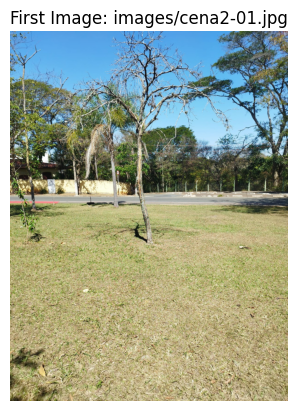

In [6]:
# Define the path and load the first 5 images
image_folder = 'images/'
image_paths = sorted(glob.glob(f'{image_folder}cena2-*.jpg'))[:5]

image_list = []
for image_path in image_paths:
    image = cv2.imread(image_path)
    image_list.append(image)

print(f"Loaded {len(image_list)} images.")
# Display the first image to check
show_image(image_list[0], title=f"First Image: {image_paths[0]}")

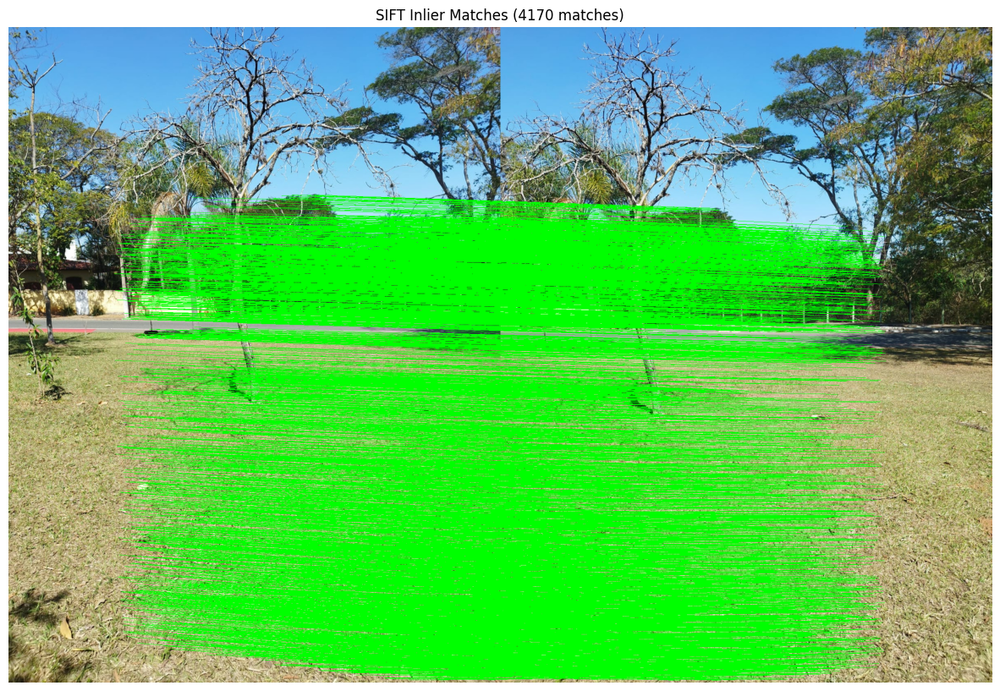

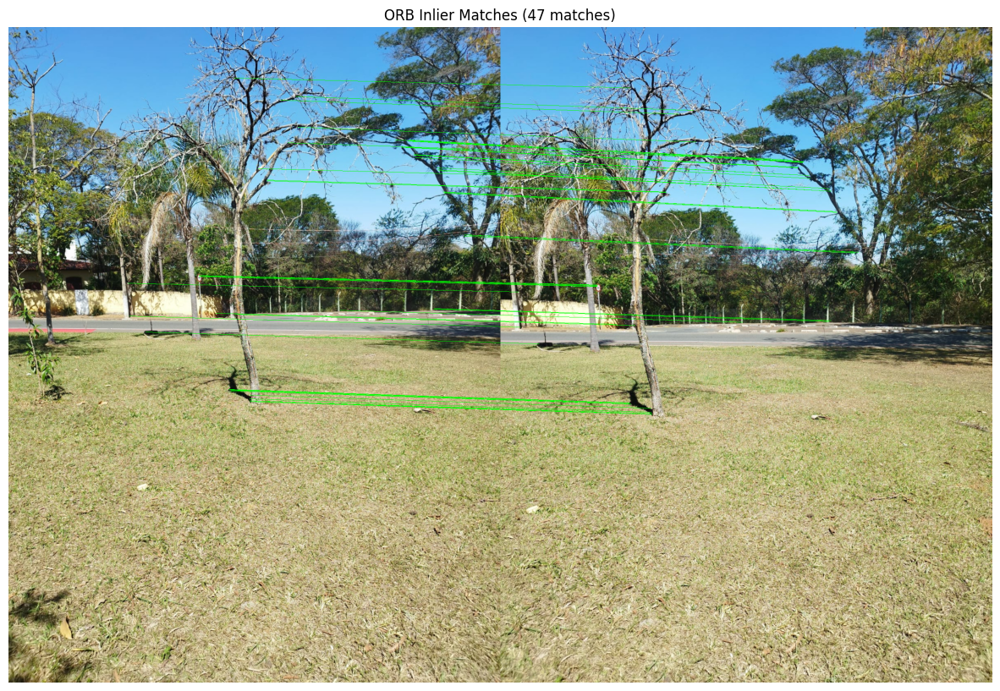

In [7]:
# Using the first two images for comparison
image_1 = image_list[0]
image_2 = image_list[1]

gray_image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2GRAY)
gray_image_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2GRAY)

# --- SIFT Detector ---
kps1_sift, feats1_sift = detect_and_describe(gray_image_1, method='sift')
kps2_sift, feats2_sift = detect_and_describe(gray_image_2, method='sift')
matches_sift_data = match_keypoints(kps1_sift, kps2_sift, feats1_sift, feats2_sift)
(good_matches_sift, points1_sift, points2_sift) = matches_sift_data
_, status_sift = cv2.findHomography(points1_sift, points2_sift, cv2.RANSAC, 5.0)
sift_matches_vis = draw_matches(image_1, image_2, kps1_sift, kps2_sift, good_matches_sift, status_sift)
show_image(sift_matches_vis, title=f"SIFT Inlier Matches ({np.sum(status_sift)} matches)", bigger=True)

# --- ORB Detector ---
kps1_orb, feats1_orb = detect_and_describe(gray_image_1, method='orb')
kps2_orb, feats2_orb = detect_and_describe(gray_image_2, method='orb')
matches_orb_data = match_keypoints(kps1_orb, kps2_orb, feats1_orb, feats2_orb)
(good_matches_orb, points1_orb, points2_orb) = matches_orb_data
_, status_orb = cv2.findHomography(points1_orb, points2_orb, cv2.RANSAC, 5.0)
orb_matches_vis = draw_matches(image_1, image_2, kps1_orb, kps2_orb, good_matches_orb, status_orb)
show_image(orb_matches_vis, title=f"ORB Inlier Matches ({np.sum(status_orb)} matches)", bigger=True)

Stitching images... This may take a moment. ⏳

--- Processing Left Side ---
Left Step 1: Stitching image 1 onto the current left panorama.
    - 📊 Metric | Re-projection Error: 8.1167 pixels
    - 📊 Metric | SSIM in Overlap: 0.4168


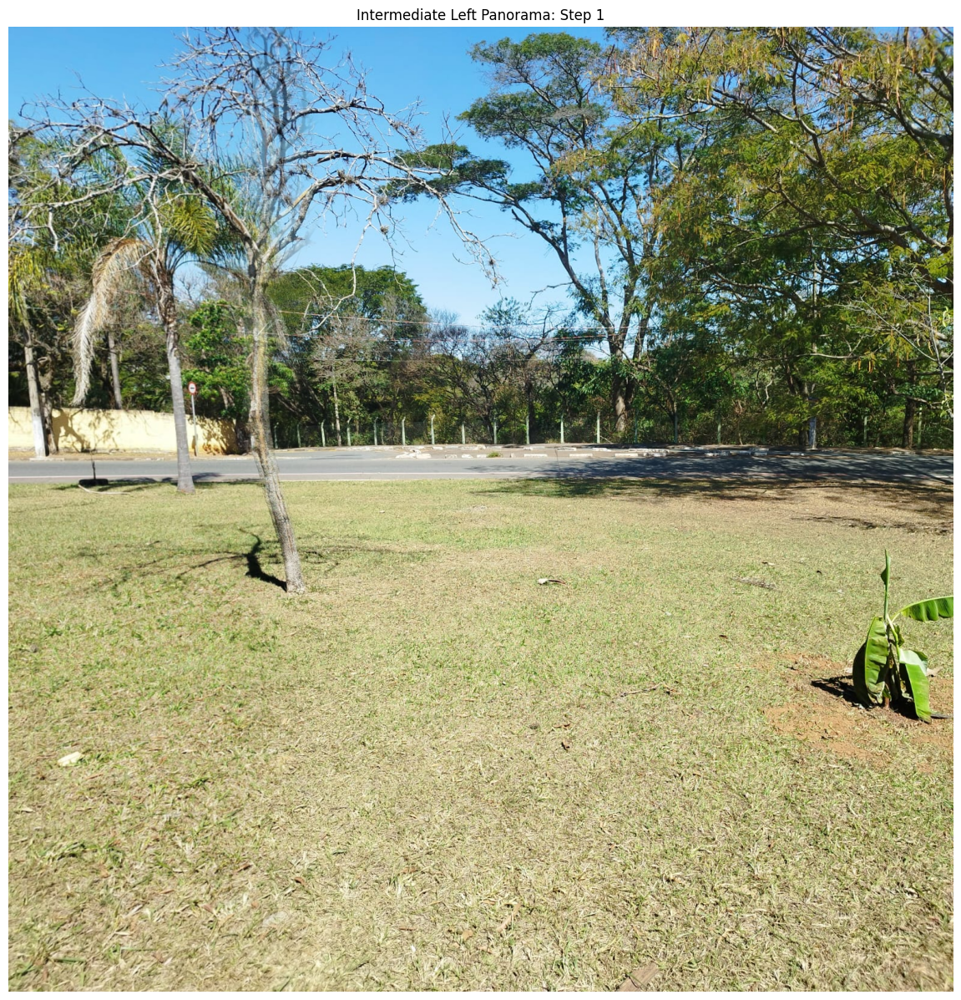

Left Step 2: Stitching image 0 onto the current left panorama.
    - 📊 Metric | Re-projection Error: 11.0095 pixels
    - 📊 Metric | SSIM in Overlap: 0.4328


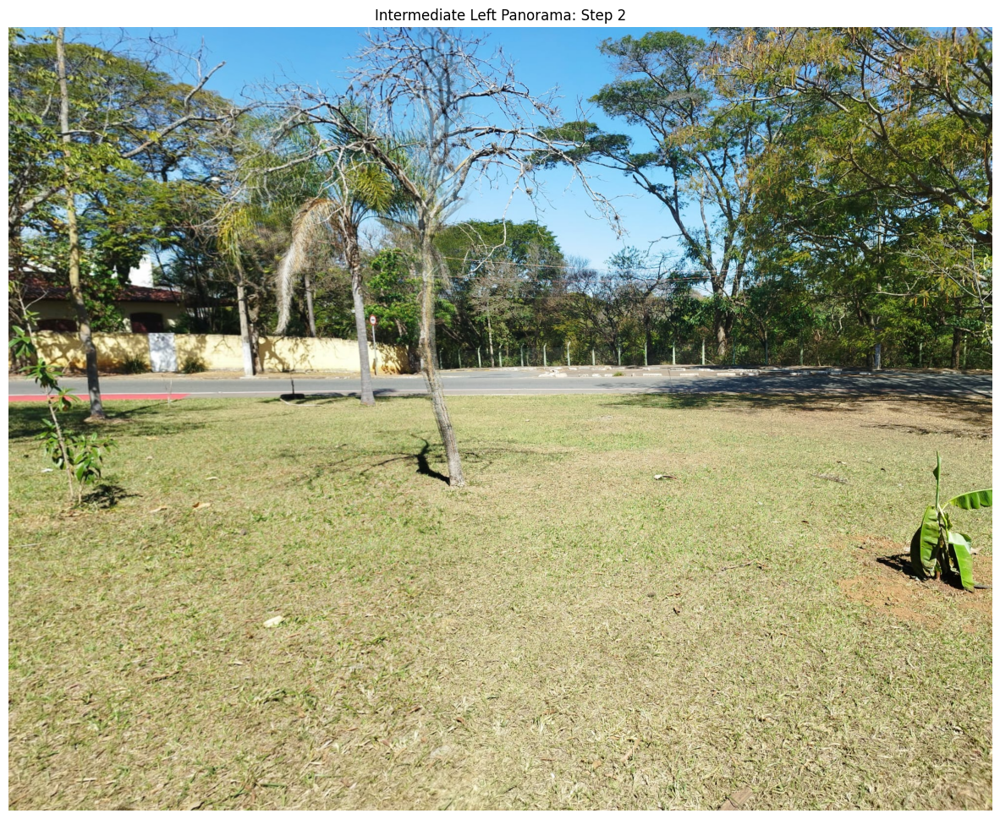


--- Processing Right Side ---
Right Step 1: Stitching image 4 onto the current right panorama.
    - 📊 Metric | Re-projection Error: 10.4277 pixels
    - 📊 Metric | SSIM in Overlap: 0.3138


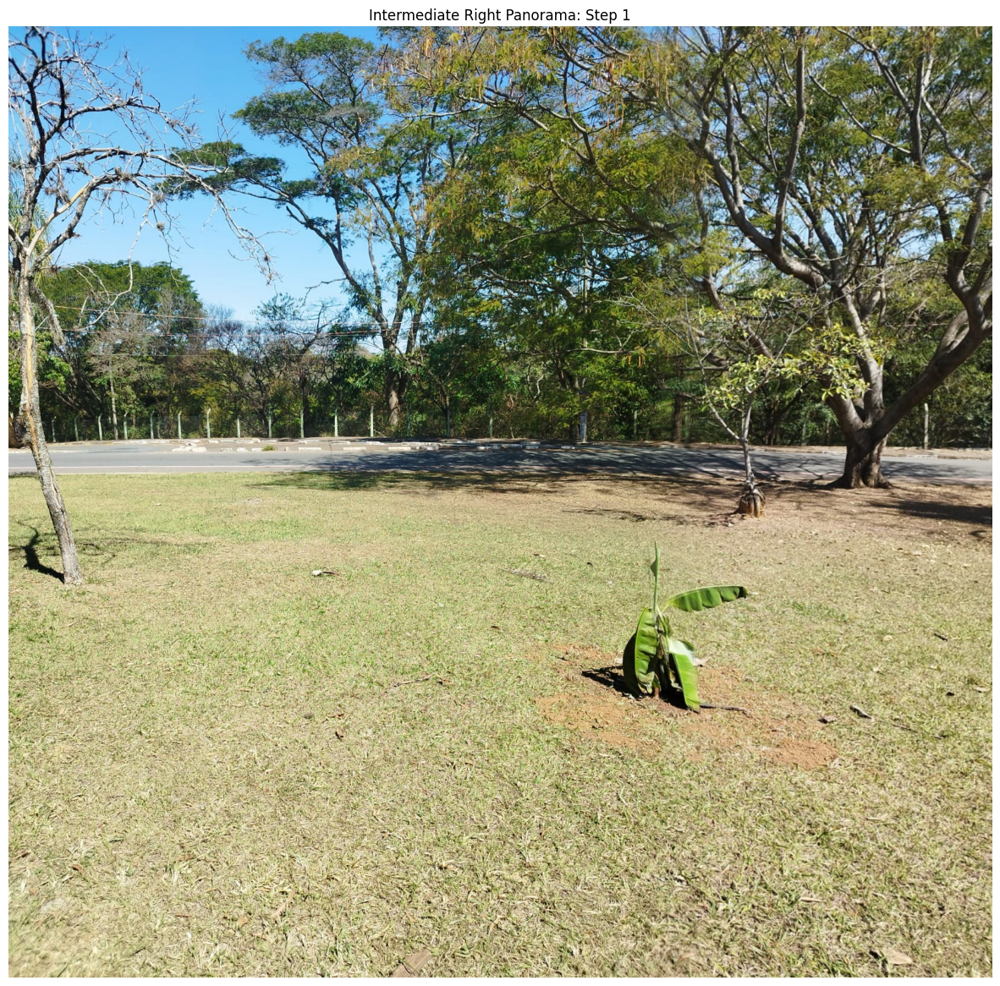

Right Step 2: Stitching image 5 onto the current right panorama.
    - 📊 Metric | Re-projection Error: 20.2609 pixels
    - 📊 Metric | SSIM in Overlap: 0.3202


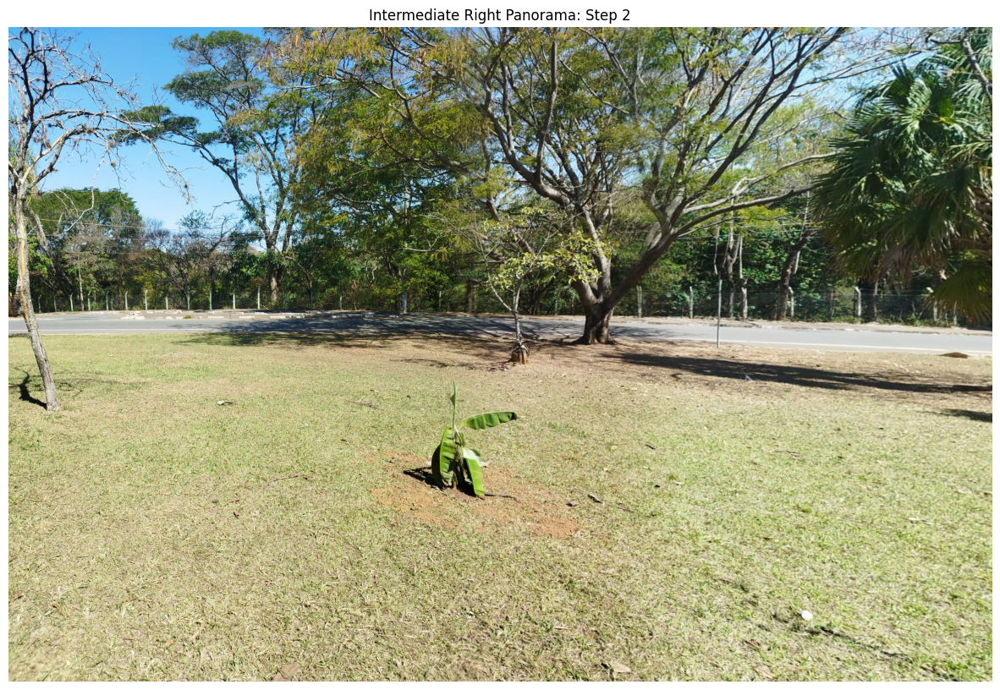


--- Final Merge: Combining Left and Right Panoramas ---
    - 📊 Metric | Re-projection Error: 3.0253 pixels
    - 📊 Metric | SSIM in Overlap: 0.9391

✅ Final panorama generated!
Stitching completed in 20.48 seconds. ✅


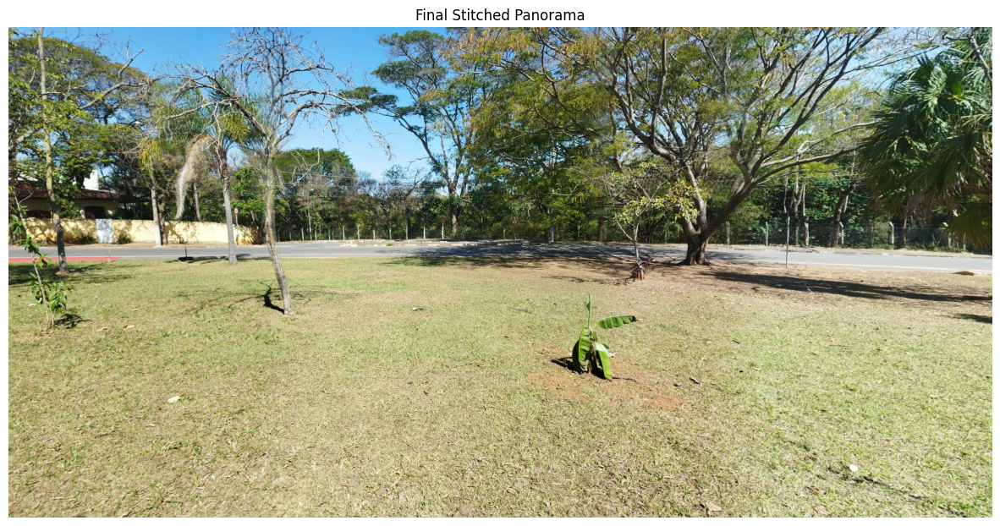

In [8]:
print("Stitching images... This may take a moment. ⏳")

# Record the start time
start_time = time.time()

# Perform the multi-image stitching
final_panorama_with_steps = create_panorama_with_steps(image_list)

# Record the end time
end_time = time.time()

print(f"Stitching completed in {end_time - start_time:.2f} seconds. ✅")

# Display the final, fully stitched panorama
show_image(final_panorama_with_steps, title="Final Stitched Panorama", bigger=True)